In [1]:
%pip install opencv-python
%pip install Pillow

C:\Users\manuc\AppData\Local\Temp\ipykernel_3772\1087648453.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("transnetv2-pytorch-weights.pth")


In [21]:
import torch
import ffmpeg
from transnet import TransNetV2
from inference import predict_video
import cv2
import numpy as np
import torch
import os
from PIL import Image, ImageTk
import tkinter as tk
from tkinter import ttk

model = TransNetV2()
state_dict = torch.load("transnetv2-pytorch-weights.pth")
model.load_state_dict(state_dict)

<All keys matched successfully>

In [9]:
with torch.no_grad():
    # shape: batch dim x video frames x frame height x frame width x RGB (not BGR) channels
    scenes = predict_video('../../Test_dataset/00112.mp4', model)
    print("Detected scenes:", scenes)
    #visualize_detection('../../Dataset/00100.mp4', scenes,'./')

Trying for ../../Test_dataset/00112.mp4
[TransNetV2] Processing video frames 7676/7676Detected scenes: [[   0   71]
 [  73  134]
 [ 135  217]
 [ 218  302]
 [ 303  366]
 [ 367  460]
 [ 461  500]
 [ 501  533]
 [ 534  567]
 [ 568  616]
 [ 617  665]
 [ 666  698]
 [ 699  765]
 [ 766  795]
 [ 796  831]
 [ 832  865]
 [ 866  897]
 [ 898  934]
 [ 935  983]
 [ 984 1028]
 [1029 1126]
 [1127 1157]
 [1158 1195]
 [1196 1232]
 [1233 1263]
 [1264 1288]
 [1289 1468]
 [1469 1492]
 [1493 1528]
 [1529 1560]
 [1561 1630]
 [1631 1658]
 [1659 1694]
 [1695 1728]
 [1729 1820]
 [1821 1838]
 [1839 1853]
 [1854 1884]
 [1885 1926]
 [1927 1947]
 [1948 2004]
 [2005 2009]
 [2010 2019]
 [2020 2050]
 [2051 2091]
 [2092 2113]
 [2114 2154]
 [2155 2169]
 [2170 2195]
 [2196 2236]
 [2237 2277]
 [2278 2298]
 [2299 2414]
 [2415 2464]
 [2465 2500]
 [2501 2517]
 [2518 2546]
 [2547 2599]
 [2600 2641]
 [2642 2724]
 [2725 2763]
 [2764 2795]
 [2796 2831]
 [2832 2857]
 [2858 2877]
 [2878 2899]
 [2900 2938]
 [2939 2959]
 [2960 2982]


In [3]:
import cv2
print(cv2.__version__)

4.11.0


In [3]:


def extract_frame(video_path, frame_idx):
    cap = cv2.VideoCapture(video_path)
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
    ret, frame = cap.read()
    cap.release()
    if not ret:
        return None
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    return Image.fromarray(frame_rgb)

def visualize_shots_scrollable(video_path, scenes_data):
    if isinstance(scenes_data, torch.Tensor):
        scenes_data = scenes_data.cpu().numpy()
    elif isinstance(scenes_data, list):
        scenes_data = np.array(scenes_data)

    root = tk.Tk()
    root.title("Shot Boundary Viewer")
    def on_closing():
        root.quit()
        root.destroy()

    root.protocol("WM_DELETE_WINDOW", on_closing)

    main_frame = ttk.Frame(root)
    main_frame.pack(fill=tk.BOTH, expand=True)

    canvas = tk.Canvas(main_frame)
    scrollbar = ttk.Scrollbar(main_frame, orient=tk.VERTICAL, command=canvas.yview)
    scrollable_frame = ttk.Frame(canvas)

    scrollable_frame.bind(
        "<Configure>",
        lambda e: canvas.configure(
            scrollregion=canvas.bbox("all")
        )
    )

    canvas.create_window((0, 0), window=scrollable_frame, anchor="nw")
    canvas.configure(yscrollcommand=scrollbar.set)

    canvas.pack(side=tk.LEFT, fill=tk.BOTH, expand=True)
    scrollbar.pack(side=tk.RIGHT, fill=tk.Y)

    for idx, (start, end) in enumerate(scenes_data):
        start_img = extract_frame(video_path, int(start))
        end_img = extract_frame(video_path, int(end))

        if start_img is None or end_img is None:
            continue

        start_img_tk = ImageTk.PhotoImage(start_img.resize((160, 90)))
        end_img_tk = ImageTk.PhotoImage(end_img.resize((160, 90)))

        pair_frame = ttk.Frame(scrollable_frame, padding=10)
        pair_frame.pack(fill=tk.X)

        ttk.Label(pair_frame, text=f"Shot {idx+1}: [{start}-{end}]").pack(anchor="w")

        images_frame = ttk.Frame(pair_frame)


        ttk.Label(images_frame, image=start_img_tk).pack(side=tk.LEFT, padx=5)
        ttk.Label(images_frame, image=end_img_tk).pack(side=tk.LEFT, padx=5)

        # Store reference to avoid garbage collection
        pair_frame.start_img_tk = start_img_tk
        pair_frame.end_img_tk = end_img_tk

    root.mainloop()

if __name__ == '__main__':
    video_file = '../../Dataset/00112.mp4'
    #example_scenes = [[0, 433], [434, 495], [496, 553], [554, 646]]
    with torch.no_grad():
    # shape: batch dim x video frames x frame height x frame width x RGB (not BGR) channels
        scenes = predict_video(video_file, model)
    scenes_np = np.array(scenes)
    print(os.path.exists("00112.mp4"))
    visualize_shots_scrollable("00112.mp4", scenes_np)



Trying for ../../Dataset/00112.mp4
[TransNetV2] Processing video frames 7676/7676True


In [ ]:
visualize_shots_scrollable("00112.mp4", scenes_np)


: 

In [ ]:
import cv2
from PIL import Image
from IPython.display import display
from typing import List, Tuple, Optional

def preview_shot_midframes(
    video_path: str,
    shots: List[Tuple[int, int]],
    max_width: Optional[int] = 600,
) -> List[Image.Image]:
    """
    Display the mid-frame for each shot in a Jupyter notebook.

    Parameters
    ----------
    video_path : str
        Path to the video file.
    shots : list[tuple[int, int]]
        List of (start_frame, end_frame) pairs you already computed.
    max_width : int | None
        Resize frames to this width for nicer notebook layout.
        Pass None to keep original resolution.

    Returns
    -------
    images : list[PIL.Image.Image]
        The mid-frame images in case you want to use them programmatically.
    """
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise FileNotFoundError(f"Could not open {video_path}")

    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    images = []

    try:
        for idx, (start_f, end_f) in enumerate(shots):
            mid_f = int(start_f + (end_f - start_f) // 2)

            if mid_f >= frame_count:
                print(f"⚠️  Shot {idx}: mid-frame {mid_f} beyond EOF ({frame_count})")
                continue

            cap.set(cv2.CAP_PROP_POS_FRAMES, mid_f)
            ok, frame = cap.read()
            if not ok:
                print(f"⚠️  Shot {idx}: can’t read frame {mid_f}")
                continue

            # BGR → RGB → PIL
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            img = Image.fromarray(frame_rgb)

            # Optional resize for display
            if max_width and img.width > max_width:
                scale = max_width / img.width
                img = img.resize(
                    (max_width, int(img.height * scale)), Image.Resampling.LANCZOS
                )

            print(f"Shot {idx}: frames {start_f}–{end_f}  (mid={mid_f})")
            display(img)


    finally:
        cap.release()

    return images


Shot 0: frames 0–71  (mid=35)


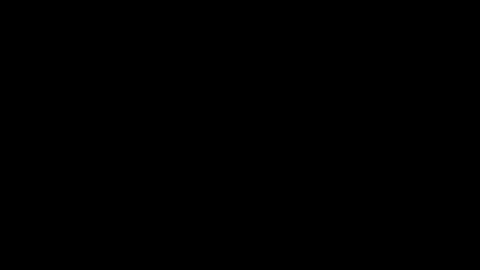

Shot 1: frames 73–134  (mid=103)


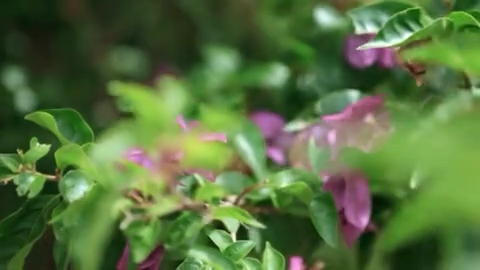

Shot 2: frames 135–217  (mid=176)


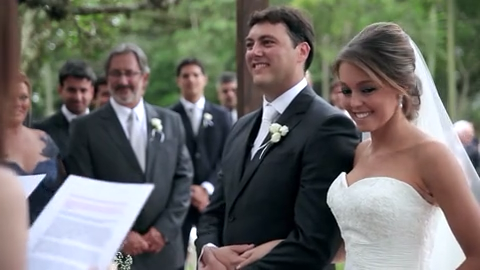

Shot 3: frames 218–302  (mid=260)


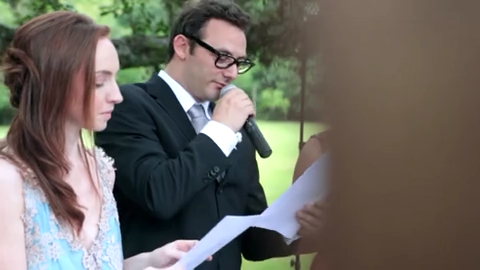

Shot 4: frames 303–366  (mid=334)


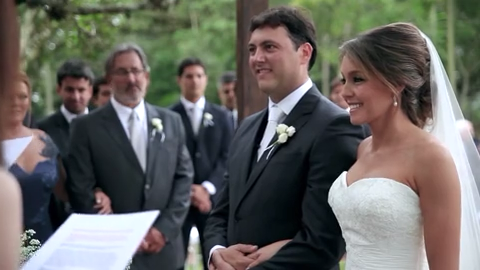

Shot 5: frames 367–460  (mid=413)


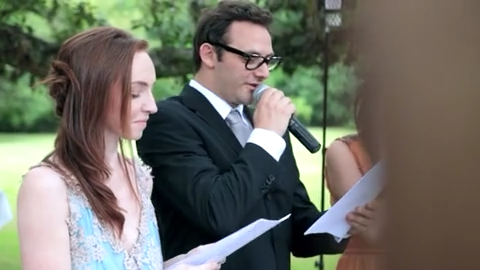

Shot 6: frames 461–500  (mid=480)


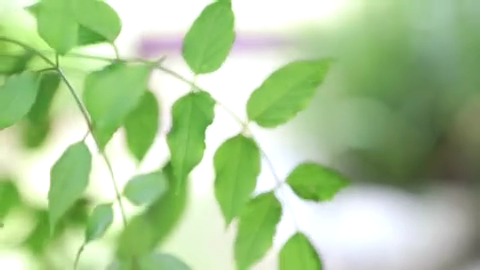

Shot 7: frames 501–533  (mid=517)


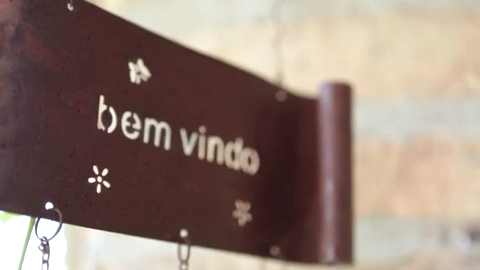

Shot 8: frames 534–567  (mid=550)


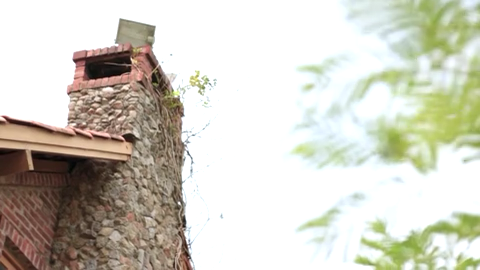

Shot 9: frames 568–616  (mid=592)


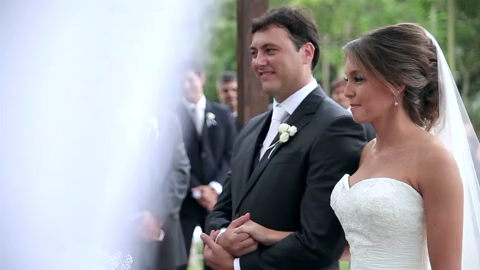

Shot 10: frames 617–665  (mid=641)


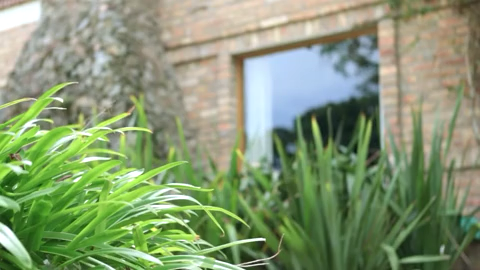

Shot 11: frames 666–698  (mid=682)


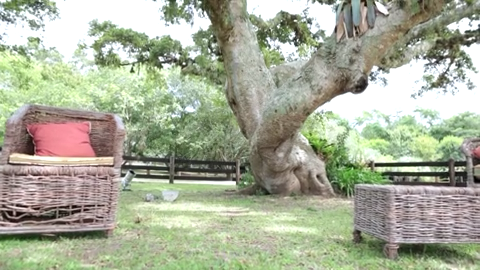

Shot 12: frames 699–765  (mid=732)


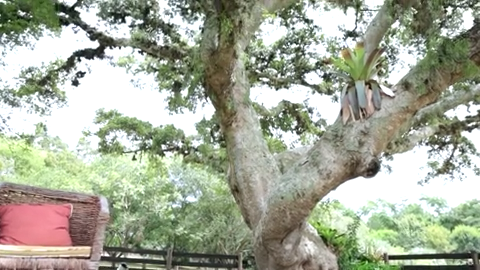

Shot 13: frames 766–795  (mid=780)


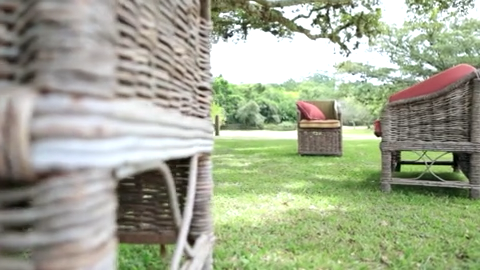

Shot 14: frames 796–831  (mid=813)


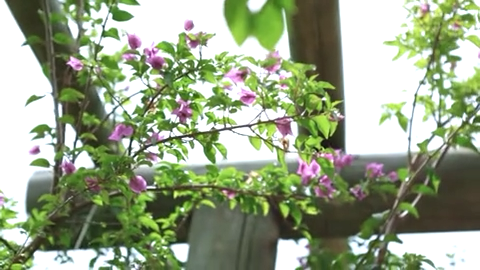

Shot 15: frames 832–865  (mid=848)


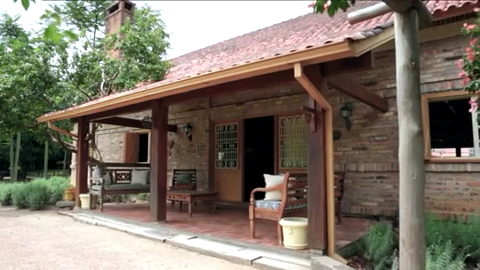

Shot 16: frames 866–897  (mid=881)


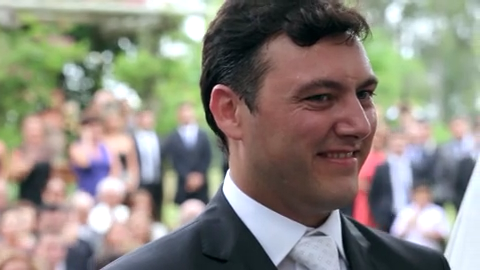

Shot 17: frames 898–934  (mid=916)


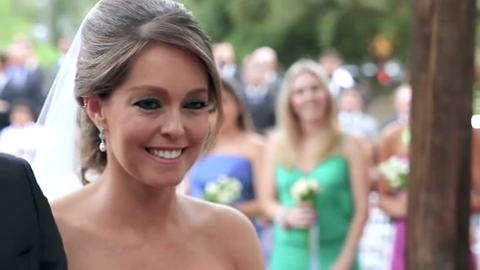

Shot 18: frames 935–983  (mid=959)


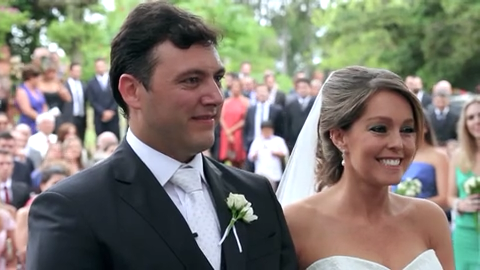

Shot 19: frames 984–1028  (mid=1006)


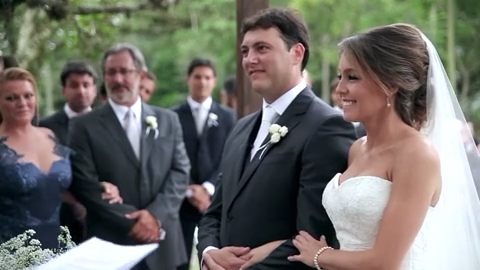

Shot 20: frames 1029–1126  (mid=1077)


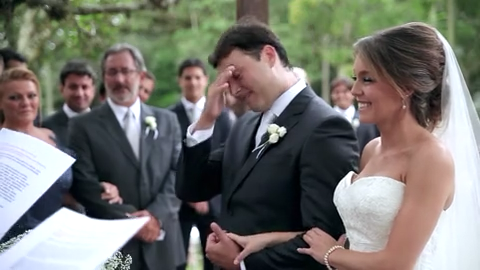

Shot 21: frames 1127–1157  (mid=1142)


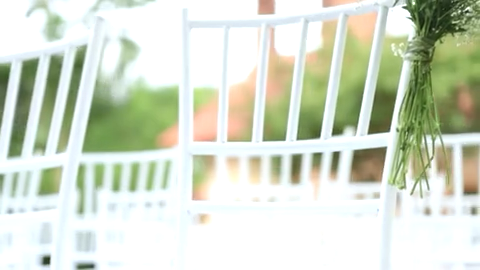

Shot 22: frames 1158–1195  (mid=1176)


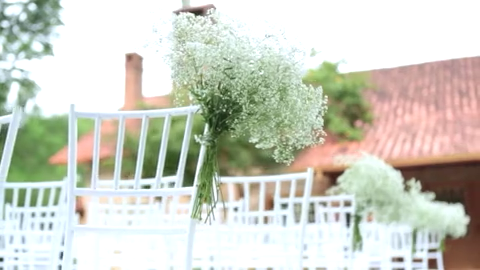

Shot 23: frames 1196–1232  (mid=1214)


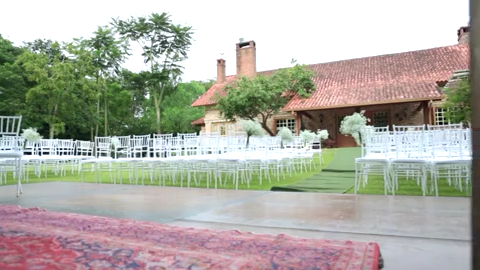

Shot 24: frames 1233–1263  (mid=1248)


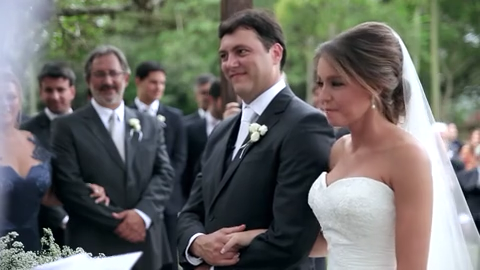

Shot 25: frames 1264–1288  (mid=1276)


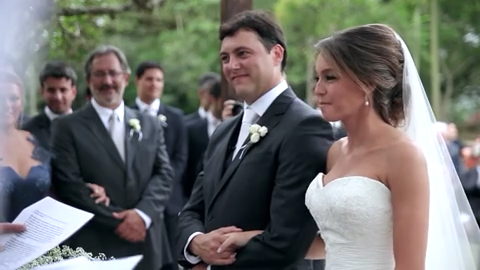

Shot 26: frames 1289–1468  (mid=1378)


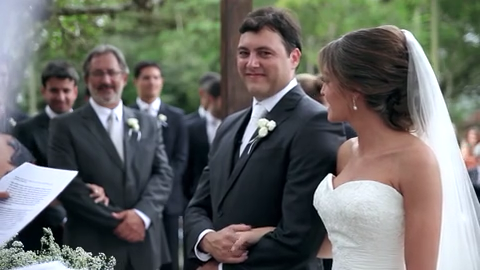

Shot 27: frames 1469–1492  (mid=1480)


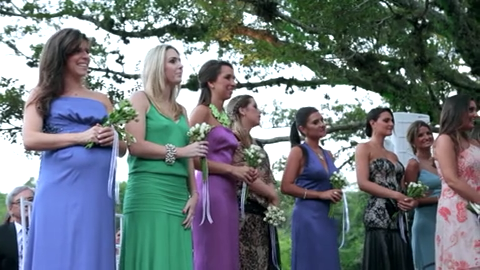

Shot 28: frames 1493–1528  (mid=1510)


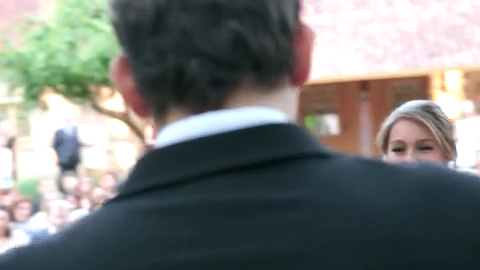

Shot 29: frames 1529–1560  (mid=1544)


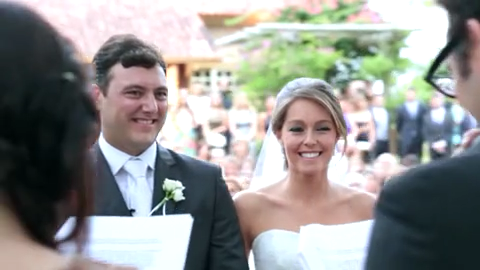

Shot 30: frames 1561–1630  (mid=1595)


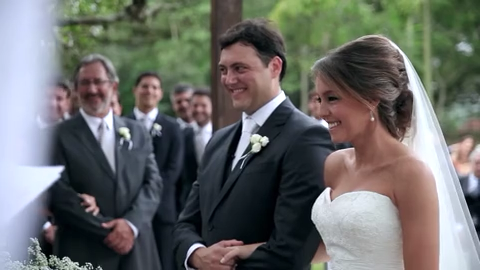

Shot 31: frames 1631–1658  (mid=1644)


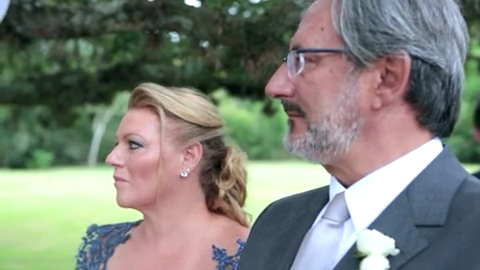

Shot 32: frames 1659–1694  (mid=1676)


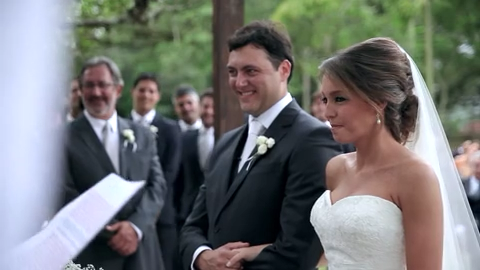

Shot 33: frames 1695–1728  (mid=1711)


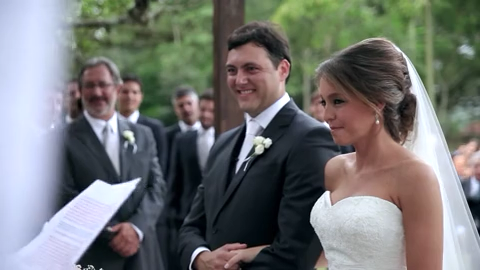

Shot 34: frames 1729–1820  (mid=1774)


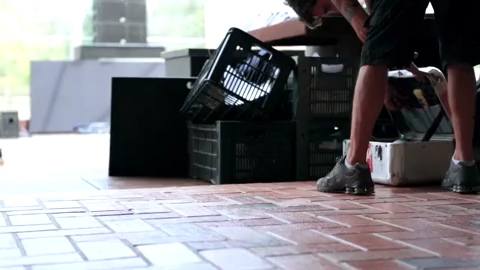

Shot 35: frames 1821–1838  (mid=1829)


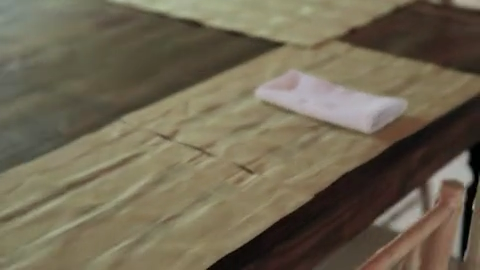

Shot 36: frames 1839–1853  (mid=1846)


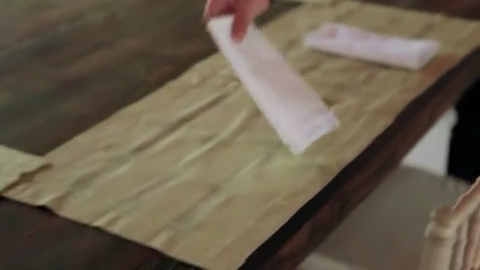

Shot 37: frames 1854–1884  (mid=1869)


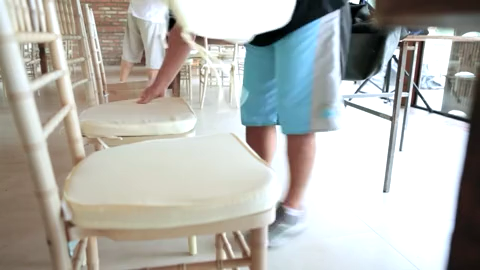

Shot 38: frames 1885–1926  (mid=1905)


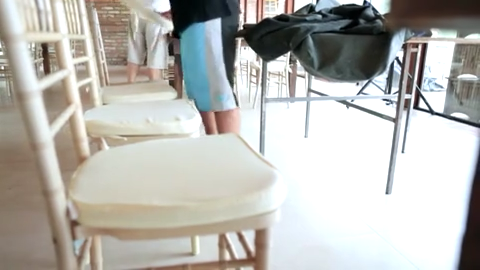

Shot 39: frames 1927–1947  (mid=1937)


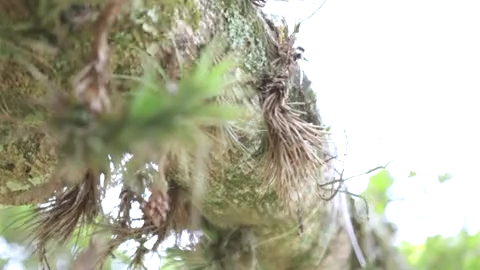

Shot 40: frames 1948–2004  (mid=1976)


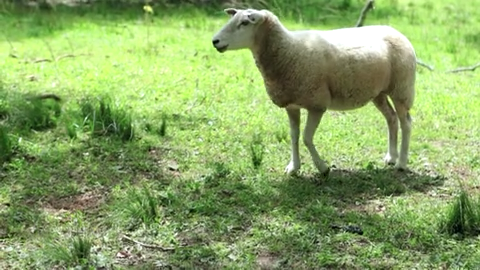

Shot 41: frames 2005–2009  (mid=2007)


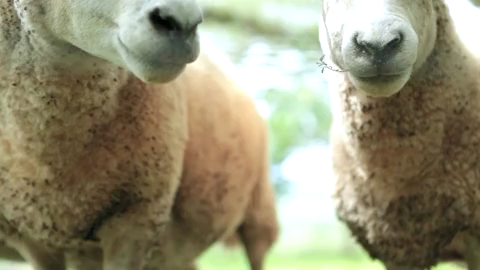

Shot 42: frames 2010–2019  (mid=2014)


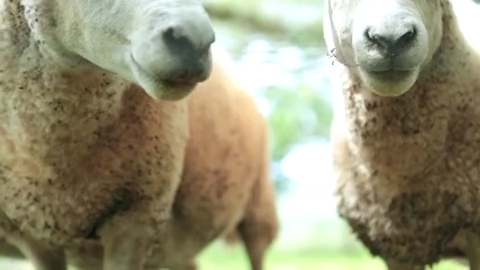

Shot 43: frames 2020–2050  (mid=2035)


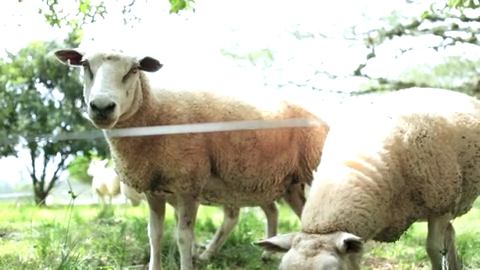

Shot 44: frames 2051–2091  (mid=2071)


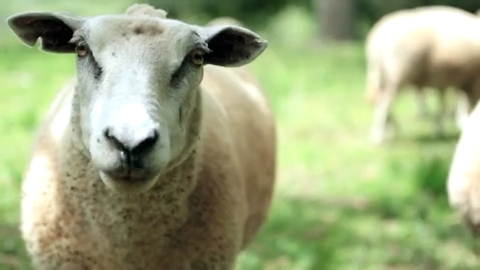

Shot 45: frames 2092–2113  (mid=2102)


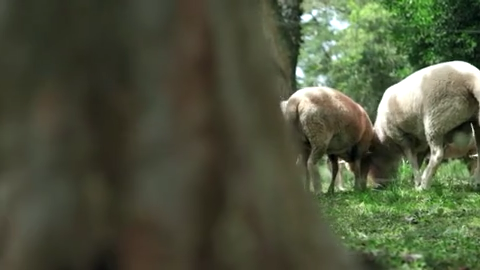

Shot 46: frames 2114–2154  (mid=2134)


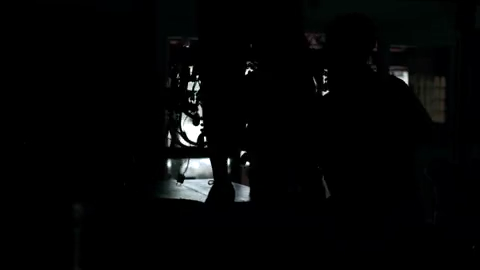

Shot 47: frames 2155–2169  (mid=2162)


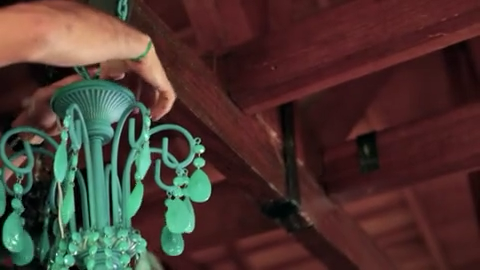

Shot 48: frames 2170–2195  (mid=2182)


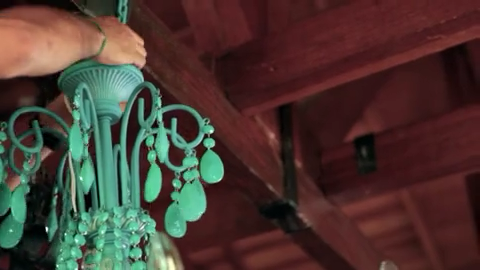

Shot 49: frames 2196–2236  (mid=2216)


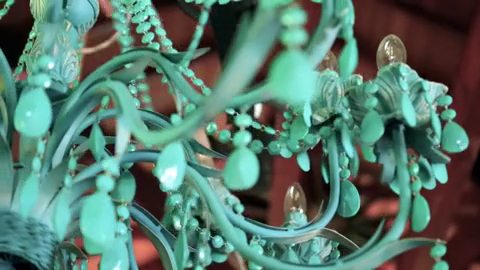

Shot 50: frames 2237–2277  (mid=2257)


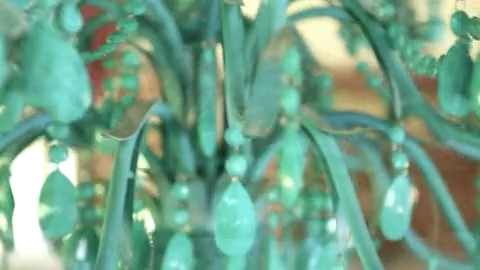

Shot 51: frames 2278–2298  (mid=2288)


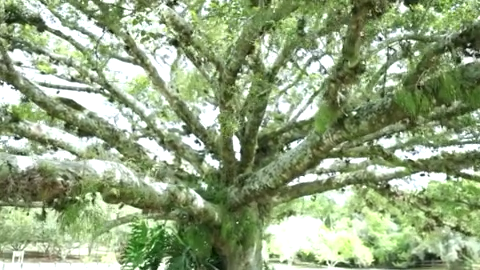

Shot 52: frames 2299–2414  (mid=2356)


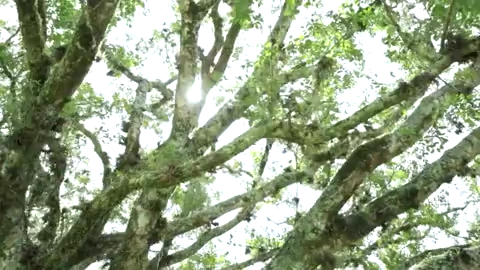

Shot 53: frames 2415–2464  (mid=2439)


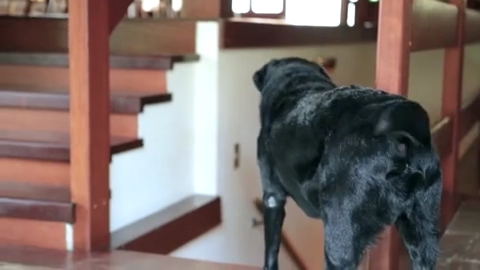

Shot 54: frames 2465–2500  (mid=2482)


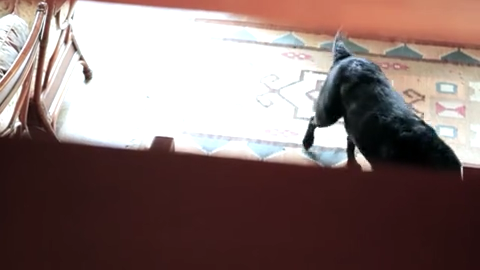

Shot 55: frames 2501–2517  (mid=2509)


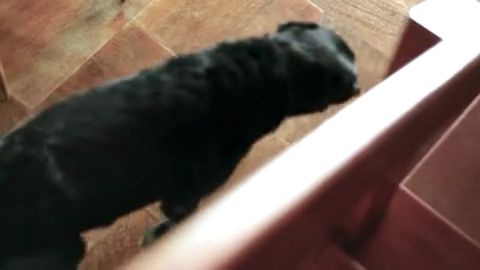

Shot 56: frames 2518–2546  (mid=2532)


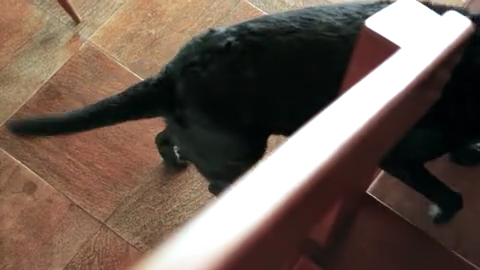

Shot 57: frames 2547–2599  (mid=2573)


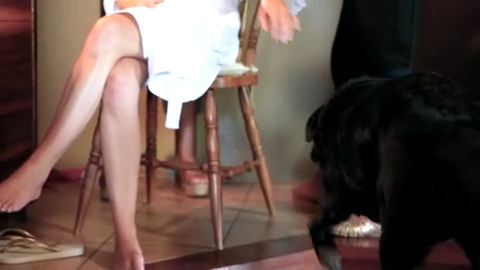

Shot 58: frames 2600–2641  (mid=2620)


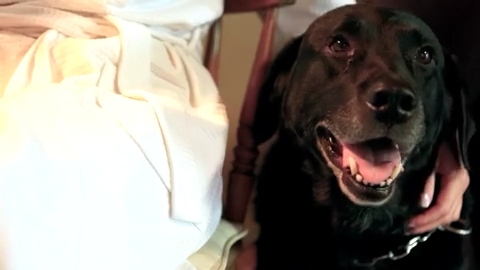

Shot 59: frames 2642–2724  (mid=2683)


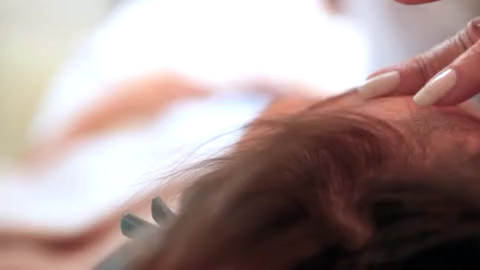

Shot 60: frames 2725–2763  (mid=2744)


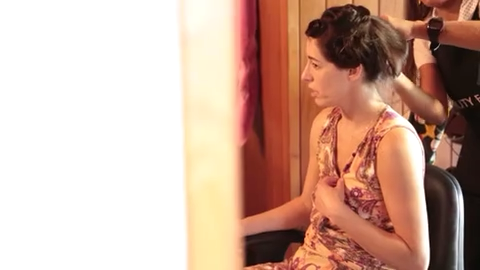

Shot 61: frames 2764–2795  (mid=2779)


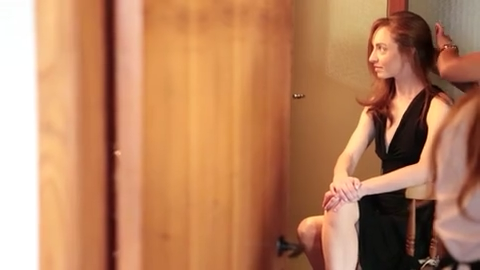

Shot 62: frames 2796–2831  (mid=2813)


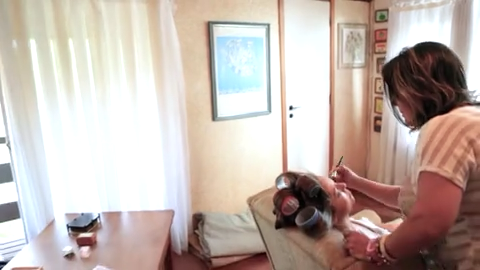

Shot 63: frames 2832–2857  (mid=2844)


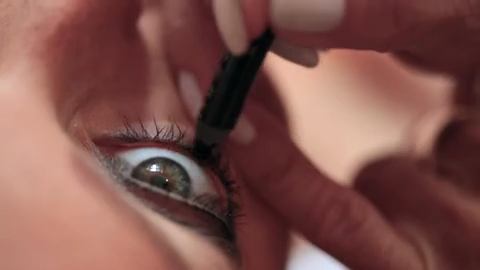

Shot 64: frames 2858–2877  (mid=2867)


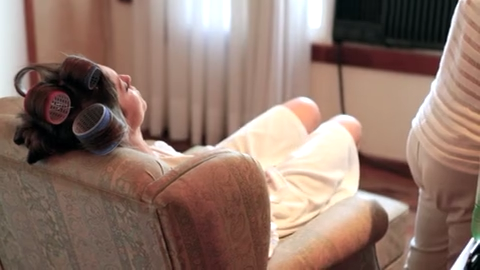

Shot 65: frames 2878–2899  (mid=2888)


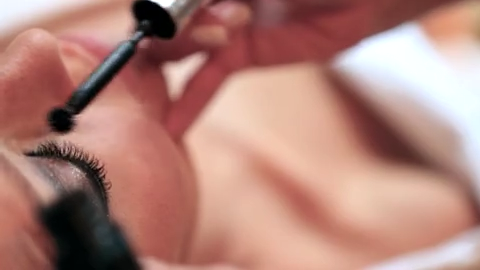

Shot 66: frames 2900–2938  (mid=2919)


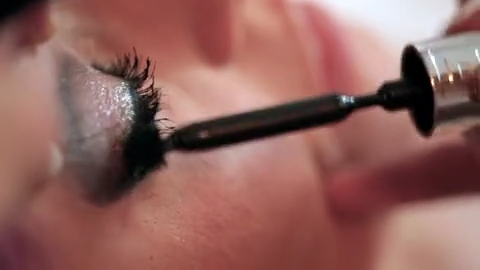

Shot 67: frames 2939–2959  (mid=2949)


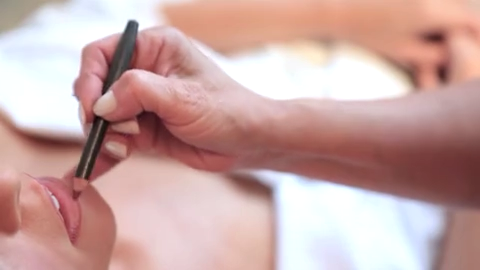

Shot 68: frames 2960–2982  (mid=2971)


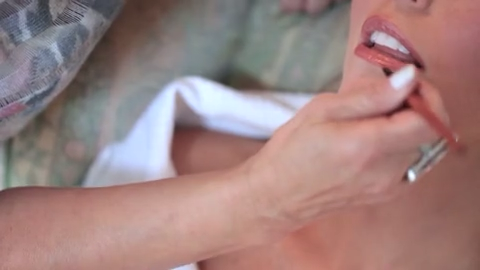

Shot 69: frames 2983–2997  (mid=2990)


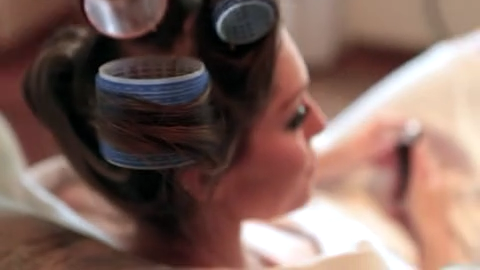

Shot 70: frames 2998–3019  (mid=3008)


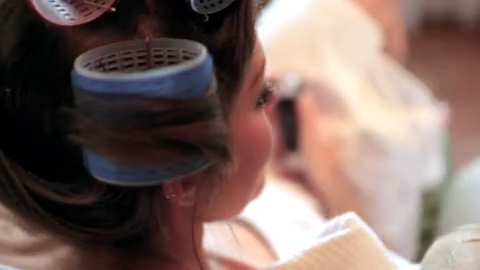

Shot 71: frames 3020–3043  (mid=3031)


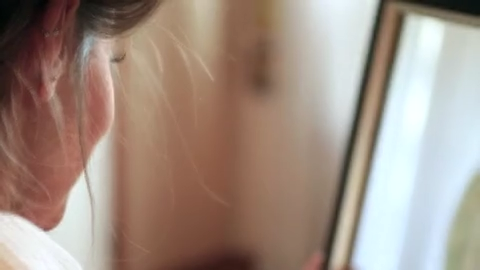

Shot 72: frames 3044–3064  (mid=3054)


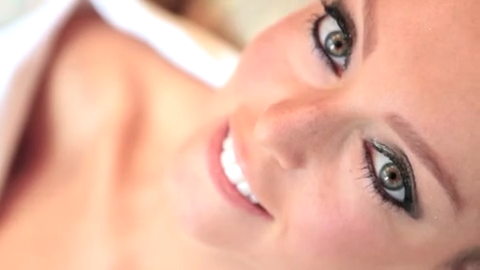

Shot 73: frames 3065–3085  (mid=3075)


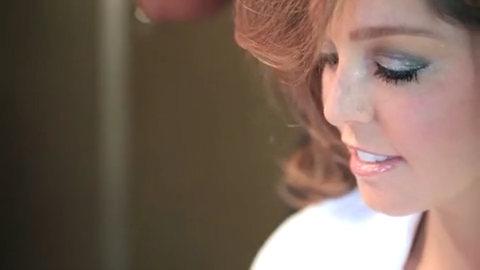

Shot 74: frames 3086–3106  (mid=3096)


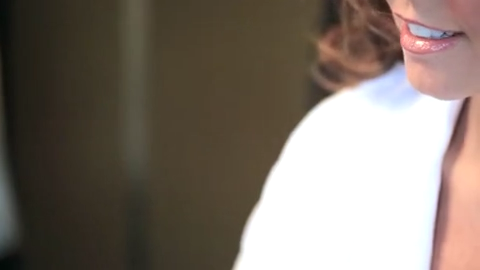

Shot 75: frames 3107–3147  (mid=3127)


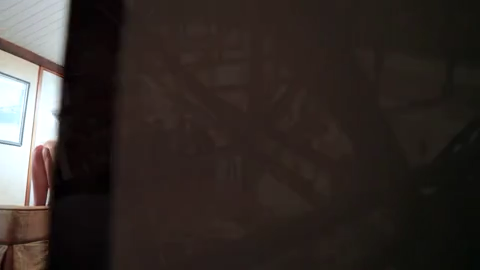

Shot 76: frames 3148–3162  (mid=3155)


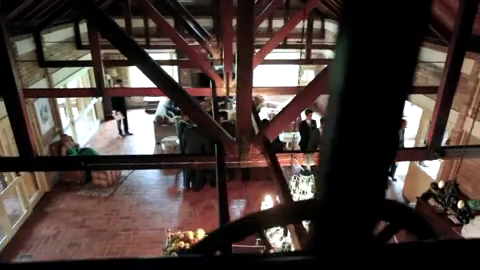

Shot 77: frames 3163–3187  (mid=3175)


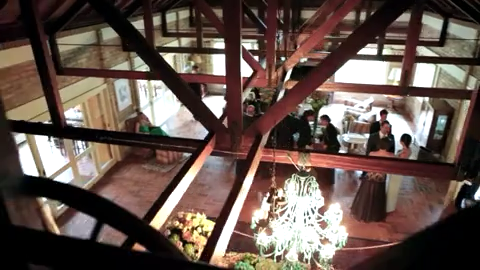

Shot 78: frames 3188–3209  (mid=3198)


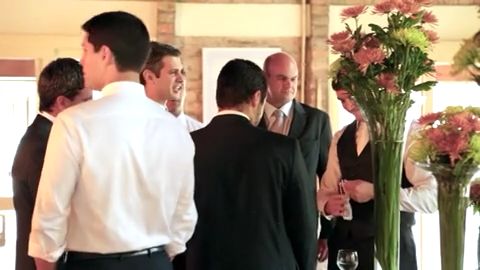

Shot 79: frames 3210–3229  (mid=3219)


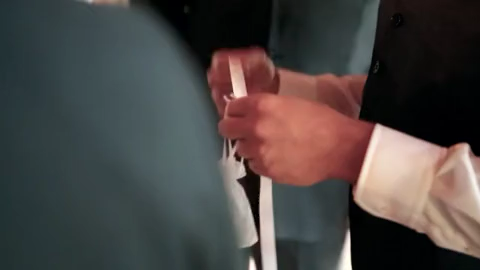

Shot 80: frames 3230–3313  (mid=3271)


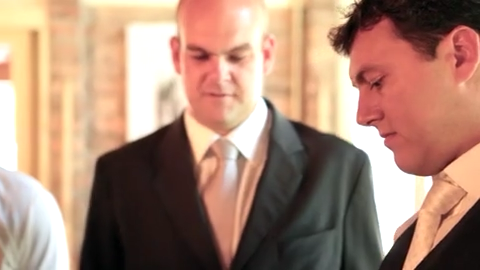

Shot 81: frames 3314–3354  (mid=3334)


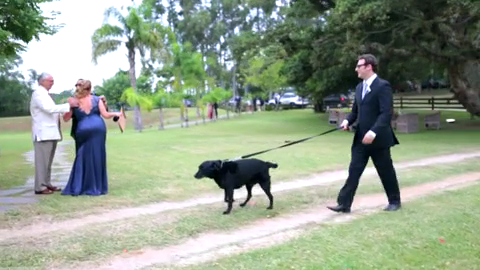

Shot 82: frames 3355–3395  (mid=3375)


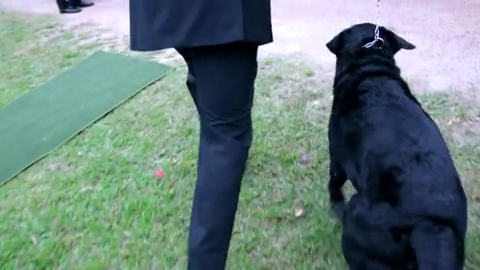

Shot 83: frames 3396–3417  (mid=3406)


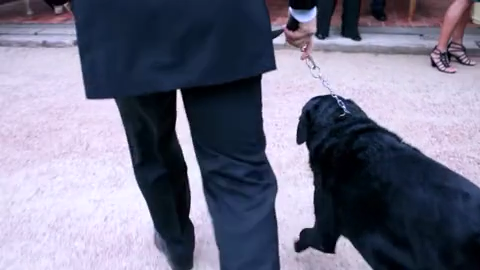

Shot 84: frames 3418–3438  (mid=3428)


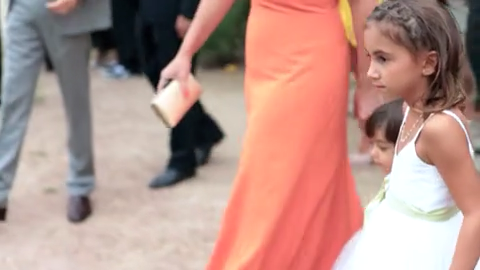

Shot 85: frames 3439–3458  (mid=3448)


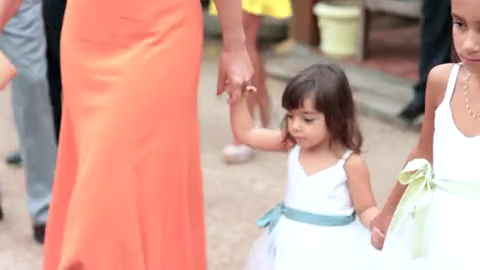

Shot 86: frames 3459–3510  (mid=3484)


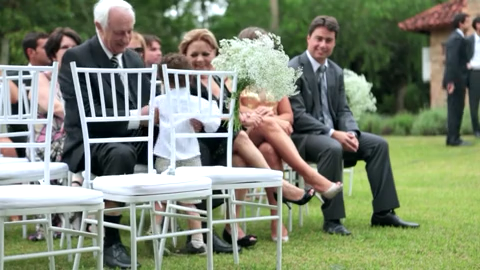

Shot 87: frames 3511–3559  (mid=3535)


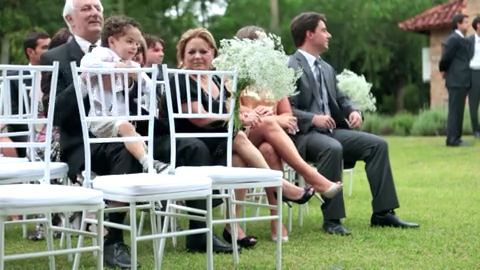

Shot 88: frames 3560–3603  (mid=3581)


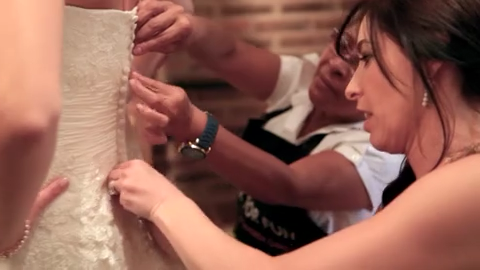

Shot 89: frames 3604–3686  (mid=3645)


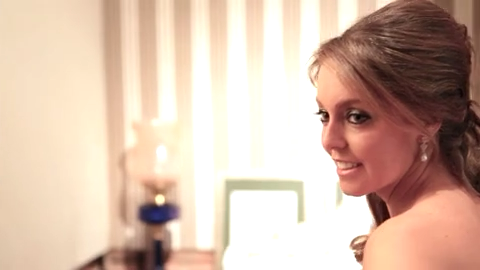

Shot 90: frames 3687–3707  (mid=3697)


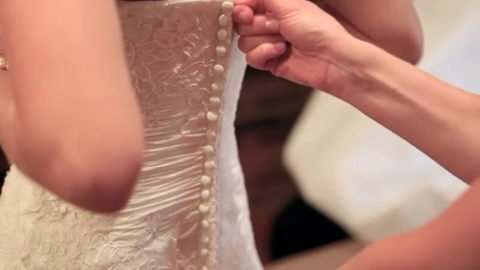

Shot 91: frames 3708–3729  (mid=3718)


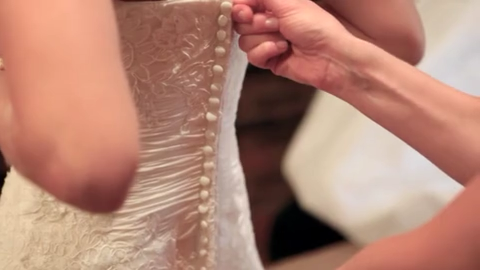

Shot 92: frames 3730–3750  (mid=3740)


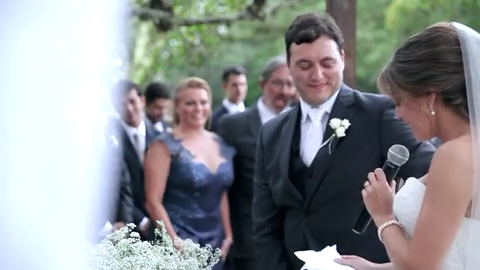

Shot 93: frames 3751–3769  (mid=3760)


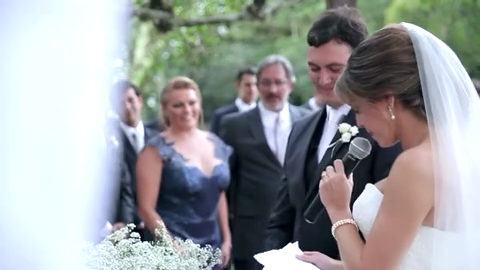

Shot 94: frames 3770–3790  (mid=3780)


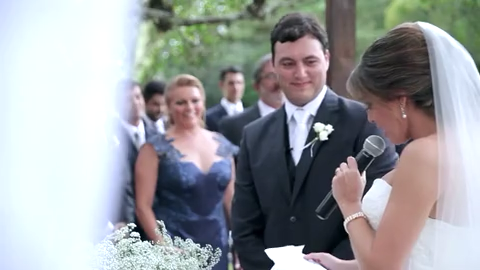

Shot 95: frames 3791–3818  (mid=3804)


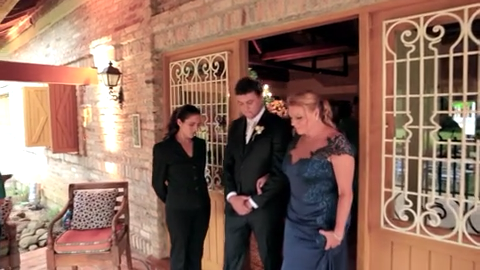

Shot 96: frames 3819–3888  (mid=3853)


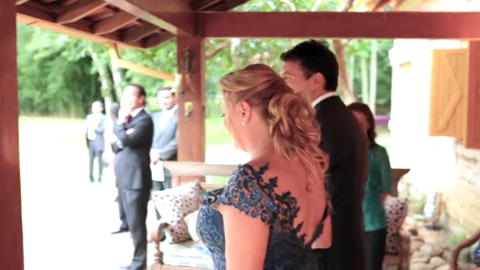

Shot 97: frames 3889–3945  (mid=3917)


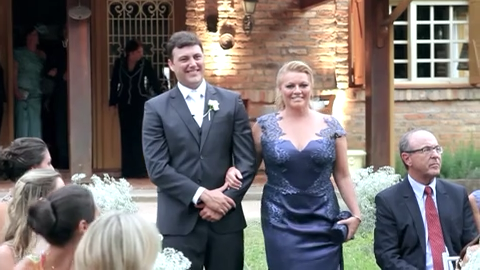

Shot 98: frames 3946–3988  (mid=3967)


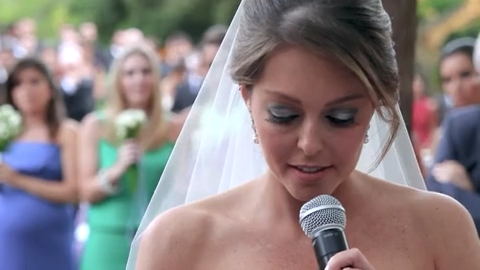

Shot 99: frames 3989–4026  (mid=4007)


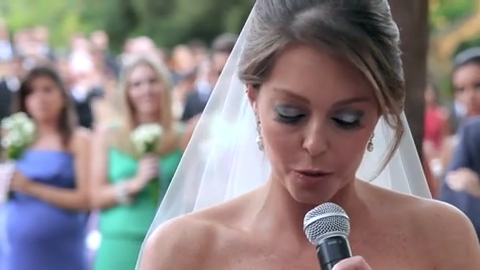

Shot 100: frames 4027–4076  (mid=4051)


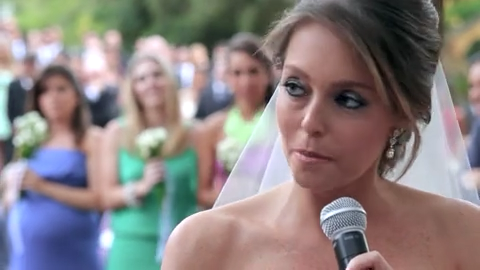

Shot 101: frames 4077–4128  (mid=4102)


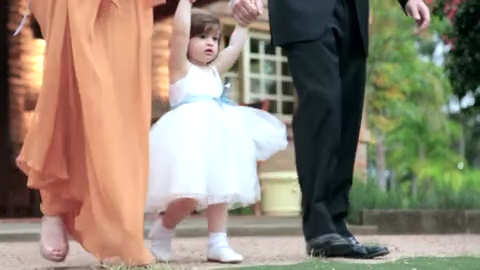

Shot 102: frames 4129–4235  (mid=4182)


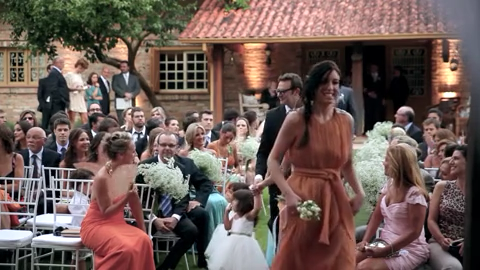

Shot 103: frames 4236–4263  (mid=4249)


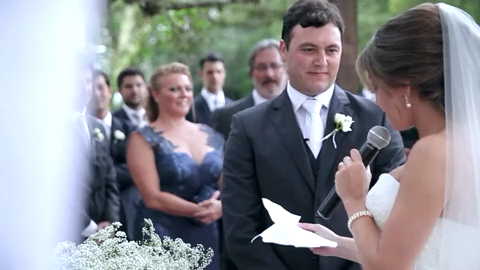

Shot 104: frames 4264–4291  (mid=4277)


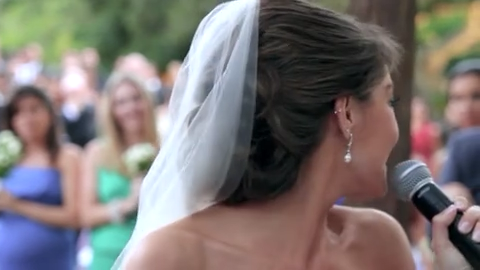

Shot 105: frames 4292–4337  (mid=4314)


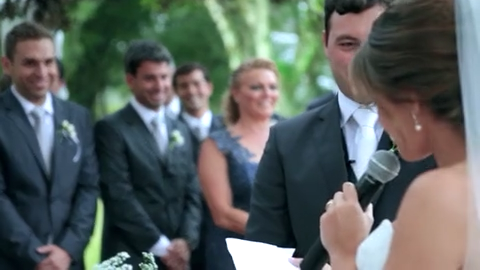

Shot 106: frames 4338–4402  (mid=4370)


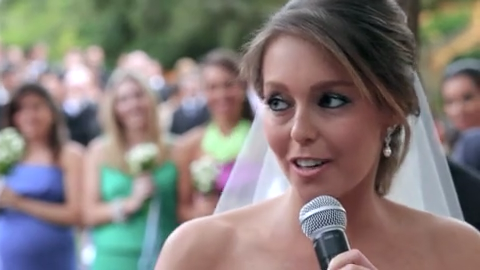

Shot 107: frames 4403–4440  (mid=4421)


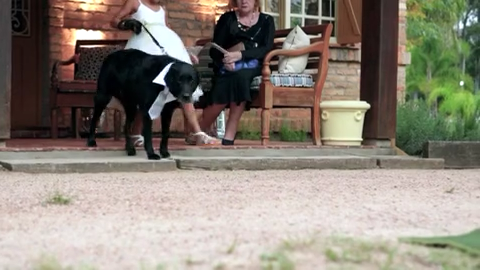

Shot 108: frames 4441–4484  (mid=4462)


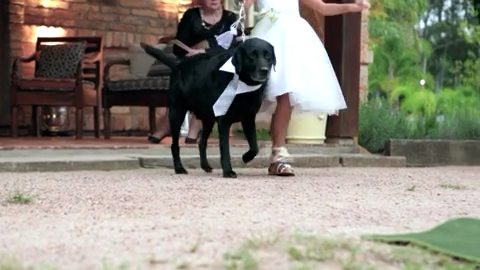

KeyboardInterrupt: 

In [22]:
preview_shot_midframes('../../Dataset/00112.mp4', scenes_np)

In [ ]:
import sys
sys.path.append('../')
from keyframe_extraction import process_video_test

In [20]:
process_video_test(scenes,'../../Dataset/00112.mp4','../results2/keyframes', None)

⚠️  Could not grab frame 7542
⚠️  Could not grab frame 7669


[{'video_id': '00112',
  'segment_index': 0,
  'start_frame': 0,
  'end_frame': 71,
  'keyframe_path': '../results2/keyframes/00112_s:0_e:71_m:35.jpg'},
 {'video_id': '00112',
  'segment_index': 1,
  'start_frame': 73,
  'end_frame': 134,
  'keyframe_path': '../results2/keyframes/00112_s:73_e:134_m:103.jpg'},
 {'video_id': '00112',
  'segment_index': 2,
  'start_frame': 135,
  'end_frame': 217,
  'keyframe_path': '../results2/keyframes/00112_s:135_e:217_m:176.jpg'},
 {'video_id': '00112',
  'segment_index': 3,
  'start_frame': 218,
  'end_frame': 302,
  'keyframe_path': '../results2/keyframes/00112_s:218_e:302_m:260.jpg'},
 {'video_id': '00112',
  'segment_index': 4,
  'start_frame': 303,
  'end_frame': 366,
  'keyframe_path': '../results2/keyframes/00112_s:303_e:366_m:334.jpg'},
 {'video_id': '00112',
  'segment_index': 5,
  'start_frame': 367,
  'end_frame': 460,
  'keyframe_path': '../results2/keyframes/00112_s:367_e:460_m:413.jpg'},
 {'video_id': '00112',
  'segment_index': 6,
  's